In [1]:
import pandas as pd
import numpy as np
import re
import seaborn as sns
import matplotlib.ticker as ticker
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import warnings
warnings.filterwarnings('ignore')

# Cases in U.S.

In [2]:
confirmed = pd.read_csv('files/time_series_covid19_confirmed_US.csv')
death = pd.read_csv('files/time_series_covid19_deaths_US.csv')

In [3]:
confirmed

,UID,iso2,iso3,code3,FIPS,Admin2,Province_State,Country_Region,Lat,Long_,...,6/26/20,6/27/20,6/28/20,6/29/20,6/30/20,7/1/20,7/2/20,7/3/20,7/4/20,7/5/20
0,16,AS,ASM,16,60.0,NaN,American Samoa,US,-14.271000,-170.132000,...,0,0,0,0,0,0,0,0,0,0
1,316,GU,GUM,316,66.0,NaN,Guam,US,13.444300,144.793700,...,247,247,247,253,257,267,280,280,280,280
2,580,MP,MNP,580,69.0,NaN,Northern Mariana Islands,US,15.097900,145.673900,...,30,30,30,30,30,30,31,31,31,31
3,630,PR,PRI,630,72.0,NaN,Puerto Rico,US,18.220800,-66.590100,...,6922,7066,7189,7250,7465,7537,7608,7683,7787,7916
4,850,VI,VIR,850,78.0,NaN,Virgin Islands,US,18.335800,-64.896300,...,81,81,81,81,81,90,92,98,111,111
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3256,84070016,US,USA,840,NaN,Central Utah,Utah,US,39.372319,-111.575868,...,127,134,143,159,169,173,180,194,201,209
3257,84070017,US,USA,840,NaN,Southeast Utah,Utah,US,38.996171,-110.701396,...,33,34,35,35,36,37,39,40,40,40
3258,84070018,US,USA,840,NaN,Southwest Utah,Utah,US,37.854472,-111.441876,...,1302,1361,1428,1467,1519,1553,1584,1625,1660,1689
3259,84070019,US,USA,840,NaN,TriCounty,Utah,US,40.124915,-109.517442,...,45,46,48,48,50,50,52,53,55,55


In [4]:
dates = [x for x in list(confirmed.columns) if re.search('/',x)]

In [5]:
confirmed_clean = confirmed.melt(id_vars=['Admin2','Province_State','Country_Region','Lat','Long_','Combined_Key'], value_vars= dates).rename(columns={'Admin2':'County','variable':'Date','value':'Total Cases'})
confirmed_clean['Date'] = pd.to_datetime(confirmed_clean['Date'], errors ='coerce')
confirmed_clean.set_index('Date',inplace = True)
confirmed_clean

,County,Province_State,Country_Region,Lat,Long_,Combined_Key,Total Cases
Date,,,,,,,
2020-01-22,NaN,American Samoa,US,-14.271000,-170.132000,"American Samoa, US",0
2020-01-22,NaN,Guam,US,13.444300,144.793700,"Guam, US",0
2020-01-22,NaN,Northern Mariana Islands,US,15.097900,145.673900,"Northern Mariana Islands, US",0
2020-01-22,NaN,Puerto Rico,US,18.220800,-66.590100,"Puerto Rico, US",0
2020-01-22,NaN,Virgin Islands,US,18.335800,-64.896300,"Virgin Islands, US",0
...,...,...,...,...,...,...,...
2020-07-05,Central Utah,Utah,US,39.372319,-111.575868,"Central Utah, Utah, US",209
2020-07-05,Southeast Utah,Utah,US,38.996171,-110.701396,"Southeast Utah, Utah, US",40
2020-07-05,Southwest Utah,Utah,US,37.854472,-111.441876,"Southwest Utah, Utah, US",1689


In [6]:
death_clean = death.melt(id_vars=['Admin2','Province_State','Country_Region','Lat','Long_','Combined_Key'], value_vars= dates).rename(columns={'Admin2':'County','variable':'Date','value':'Total Death'})
death_clean['Date'] = pd.to_datetime(death_clean['Date'])
death_clean.set_index('Date',inplace = True)
death_clean

,County,Province_State,Country_Region,Lat,Long_,Combined_Key,Total Death
Date,,,,,,,
2020-01-22,NaN,American Samoa,US,-14.271000,-170.132000,"American Samoa, US",0
2020-01-22,NaN,Guam,US,13.444300,144.793700,"Guam, US",0
2020-01-22,NaN,Northern Mariana Islands,US,15.097900,145.673900,"Northern Mariana Islands, US",0
2020-01-22,NaN,Puerto Rico,US,18.220800,-66.590100,"Puerto Rico, US",0
2020-01-22,NaN,Virgin Islands,US,18.335800,-64.896300,"Virgin Islands, US",0
...,...,...,...,...,...,...,...
2020-07-05,Central Utah,Utah,US,39.372319,-111.575868,"Central Utah, Utah, US",0
2020-07-05,Southeast Utah,Utah,US,38.996171,-110.701396,"Southeast Utah, Utah, US",0
2020-07-05,Southwest Utah,Utah,US,37.854472,-111.441876,"Southwest Utah, Utah, US",13


In [7]:
states = list(confirmed_clean['Province_State'].unique())

### Trends of Daily New Cases and Death for Each State

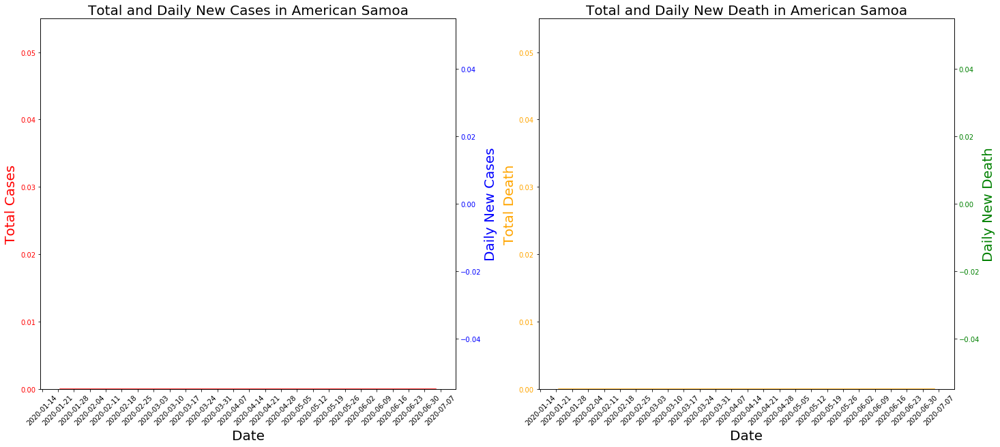

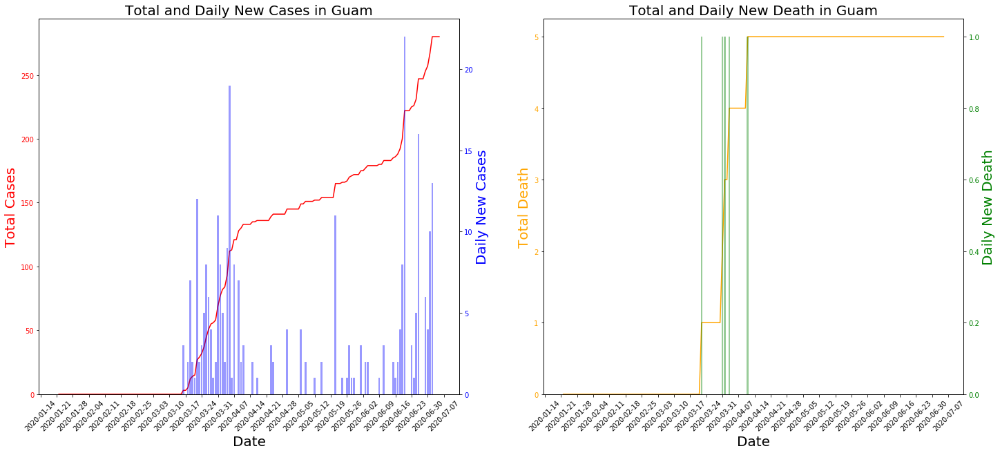

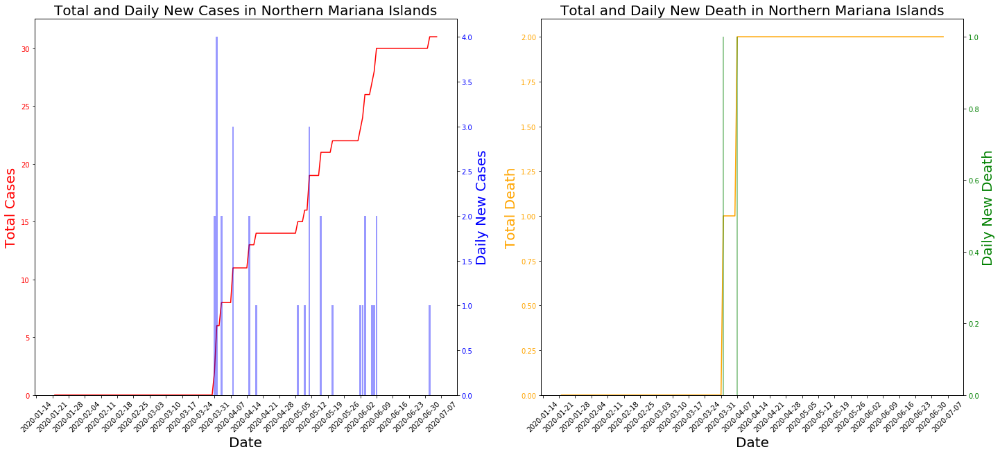

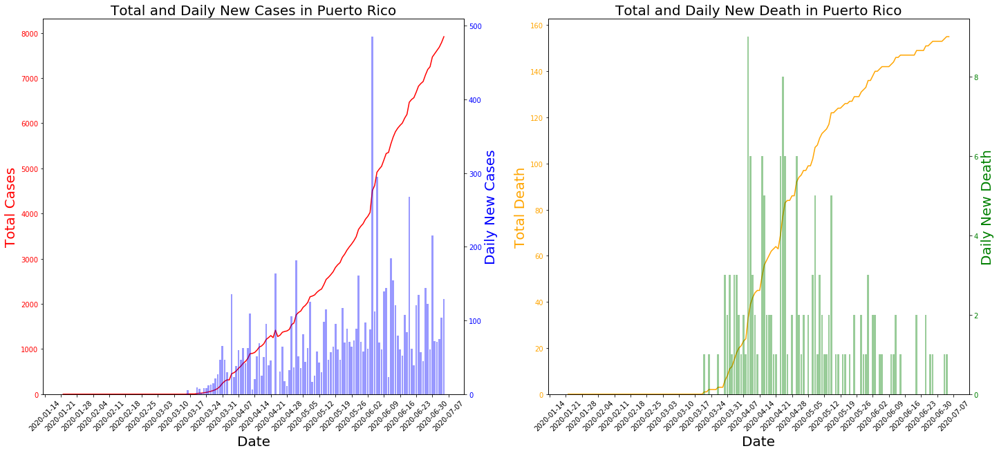

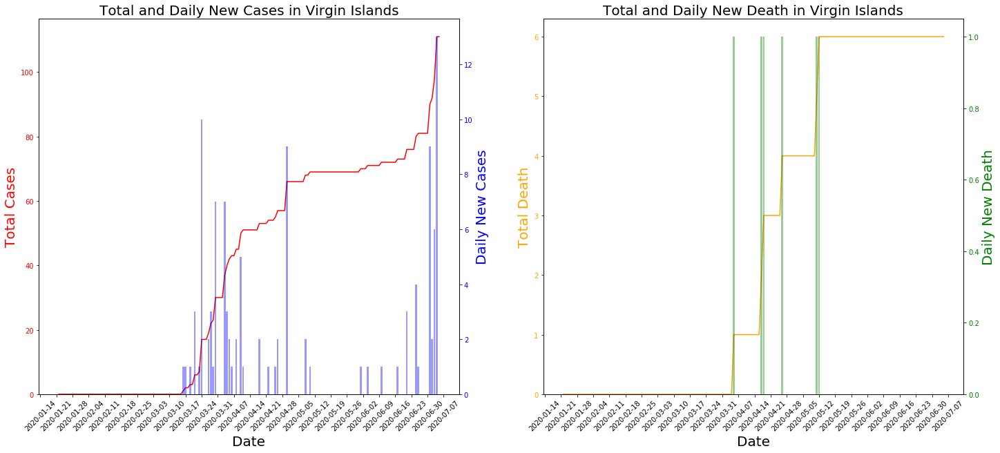

...

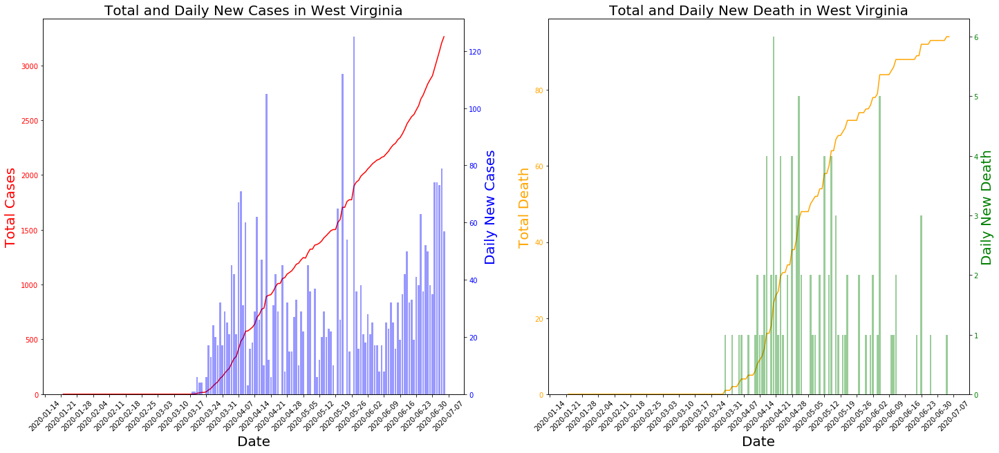

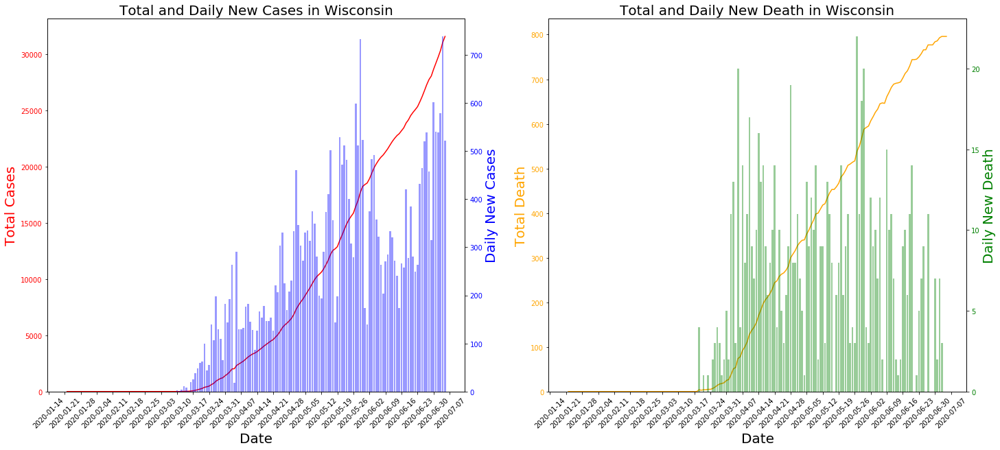

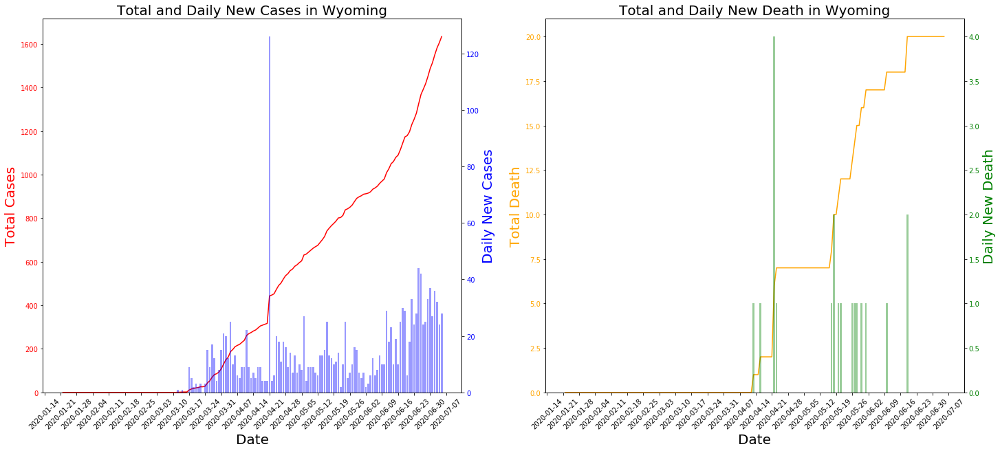

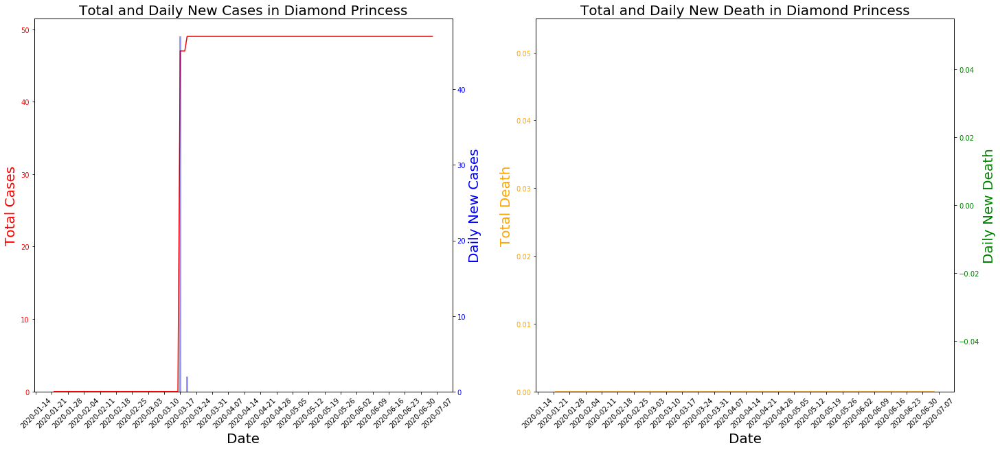

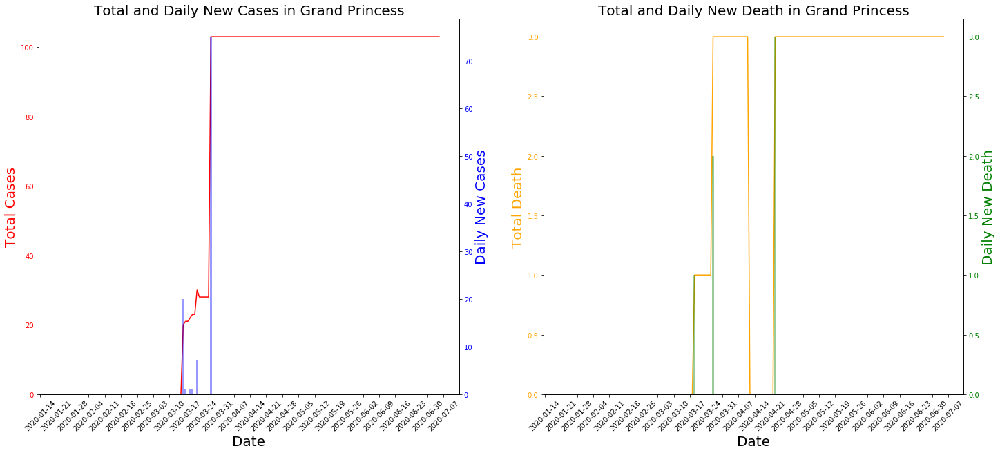

In [8]:
data = {}

for state in states:
    
    ### New cases
    state_new = confirmed_clean.loc[confirmed_clean['Province_State'] == state]
    state_new_agg = state_new.groupby('Date')[['Total Cases']].sum().reset_index()
    state_new_agg['New Cases'] = [state_new_agg['Total Cases'][0]] + \
                 [y-x if y>x else 0 for x,y in zip(state_new_agg['Total Cases'][:-1],state_new_agg['Total Cases'][1:])]
    state_new_agg.set_index('Date',inplace = True)
    
    ### Death
    state_death = death_clean.loc[death_clean['Province_State']== state]
    state_death_agg = state_death.groupby('Date')[['Total Death']].sum().reset_index()
    state_death_agg['New Death'] =[state_death_agg['Total Death'][0]]+ \
                   [y-x if y>x else 0 for x,y in zip(state_death_agg['Total Death'][:-1],state_death_agg['Total Death'][1:])]
    state_death_agg.set_index('Date',inplace = True)
    
    data['%s' % state] = state_new_agg.merge(state_death_agg, left_index = True, right_index = True)
    data['%s' % state]['State'] = state
    data['%s' % state].reset_index(inplace = True)

    ### Plot
    
    fig, axs = plt.subplots(nrows = 1, ncols = 2, figsize=(24,10))
    ax2 = axs[0].twinx()
    ax3 = axs[1].twinx()
    axs[0].plot(data['%s' % state]['Date'], data['%s' % state]['Total Cases'], 'r-')
    axs[0].tick_params(axis = 'y', labelcolor='r')
    axs[0].tick_params(axis = 'x', labelrotation = 45)
    axs[0].set_ylim(0)
    axs[0].set_xlabel('Date',fontsize = 20)
    axs[0].set_ylabel('Total Cases', color='r',fontsize = 20)
    ax2.bar(data['%s' % state]['Date'],data['%s' % state]['New Cases'], color = 'b', alpha= 0.4)
    ax2.tick_params(axis = 'y',labelcolor='b')
    ax2.set_ylabel('Daily New Cases', color='b',fontsize = 20)
    
    axs[0].xaxis.set_major_locator(mdates.WeekdayLocator(interval=1))
    axs[0].set_title('Total and Daily New Cases in %s' %state,fontsize = 20)

    
    axs[1].plot(data['%s' % state]['Date'], data['%s' % state]['Total Death'], '-',color = 'orange')
    axs[1].tick_params(axis = 'y', labelcolor='orange')
    axs[1].tick_params(axis = 'x', labelrotation = 45)
    axs[1].set_ylim(0)
    axs[1].set_xlabel('Date',fontsize = 20)
    axs[1].set_ylabel('Total Death', color='orange',fontsize = 20)
    ax3.bar(data['%s' % state]['Date'], data['%s' % state]['New Death'], color = 'green', alpha= 0.4)
    ax3.tick_params(axis = 'y',labelcolor='green')
    ax3.set_ylabel('Daily New Death', color='green',fontsize = 20)
    
    axs[1].xaxis.set_major_locator(mdates.WeekdayLocator(interval=1))
    axs[1].set_title('Total and Daily New Death in %s' %state,fontsize = 20)
    plt.show();

# Global Cases

In [9]:
confirmed_g = pd.read_csv('files/time_series_covid19_confirmed_global.csv')
death_g = pd.read_csv('files/time_series_covid19_deaths_global.csv')
recovered_g = pd.read_csv('files/time_series_covid19_recovered_global.csv')

In [10]:
confirmed_g_clean = confirmed_g.melt(id_vars=['Province/State','Country/Region','Lat','Long'], value_vars= dates).rename(columns={'variable':'Date','value':'Total Cases'})
confirmed_g_clean['Date'] = pd.to_datetime(confirmed_g_clean['Date'], errors ='coerce')
confirmed_g_clean.set_index('Date',inplace = True)
confirmed_g_clean.head(10)

,Province/State,Country/Region,Lat,Long,Total Cases
Date,,,,,
2020-01-22,NaN,Afghanistan,33.0000,65.0000,0
2020-01-22,NaN,Albania,41.1533,20.1683,0
2020-01-22,NaN,Algeria,28.0339,1.6596,0
2020-01-22,NaN,Andorra,42.5063,1.5218,0
2020-01-22,NaN,Angola,-11.2027,17.8739,0
2020-01-22,NaN,Antigua and Barbuda,17.0608,-61.7964,0
2020-01-22,NaN,Argentina,-38.4161,-63.6167,0
2020-01-22,NaN,Armenia,40.0691,45.0382,0
2020-01-22,Australian Capital Territory,Australia,-35.4735,149.0124,0


In [11]:
death_g_clean = death_g.melt(id_vars=['Province/State','Country/Region','Lat','Long'], value_vars= dates).rename(columns={'variable':'Date','value':'Total Death'})
death_g_clean['Date'] = pd.to_datetime(death_g_clean['Date'], errors ='coerce')
death_g_clean.set_index('Date',inplace = True)
death_g_clean.head(10)

,Province/State,Country/Region,Lat,Long,Total Death
Date,,,,,
2020-01-22,NaN,Afghanistan,33.0000,65.0000,0
2020-01-22,NaN,Albania,41.1533,20.1683,0
2020-01-22,NaN,Algeria,28.0339,1.6596,0
2020-01-22,NaN,Andorra,42.5063,1.5218,0
2020-01-22,NaN,Angola,-11.2027,17.8739,0
2020-01-22,NaN,Antigua and Barbuda,17.0608,-61.7964,0
2020-01-22,NaN,Argentina,-38.4161,-63.6167,0
2020-01-22,NaN,Armenia,40.0691,45.0382,0
2020-01-22,Australian Capital Territory,Australia,-35.4735,149.0124,0


In [12]:
recovered_g_clean = recovered_g.melt(id_vars=['Province/State','Country/Region','Lat','Long'], value_vars= dates).rename(columns={'variable':'Date','value':'Total Recovered'})
recovered_g_clean['Date'] = pd.to_datetime(recovered_g_clean['Date'], errors ='coerce')
recovered_g_clean.set_index('Date',inplace = True)
recovered_g_clean.head(10)

,Province/State,Country/Region,Lat,Long,Total Recovered
Date,,,,,
2020-01-22,NaN,Afghanistan,33.0000,65.0000,0
2020-01-22,NaN,Albania,41.1533,20.1683,0
2020-01-22,NaN,Algeria,28.0339,1.6596,0
2020-01-22,NaN,Andorra,42.5063,1.5218,0
2020-01-22,NaN,Angola,-11.2027,17.8739,0
2020-01-22,NaN,Antigua and Barbuda,17.0608,-61.7964,0
2020-01-22,NaN,Argentina,-38.4161,-63.6167,0
2020-01-22,NaN,Armenia,40.0691,45.0382,0
2020-01-22,Australian Capital Territory,Australia,-35.4735,149.0124,0


In [13]:
regions = confirmed_g['Country/Region'].unique()

In [14]:
data_g = {}

for region in regions:
    ### New cases
    new = confirmed_g_clean.loc[confirmed_g_clean['Country/Region'] == region]
    new_agg = new.groupby('Date')[['Total Cases']].sum().reset_index()
    new_agg['New Cases'] = [new_agg['Total Cases'][0]] + \
                [y-x if y>x else 0 for x,y in zip(new_agg['Total Cases'][:-1], new_agg['Total Cases'][1:])]
    new_agg.set_index('Date',inplace = True)   
    
    ### Death
    death = death_g_clean.loc[death_g_clean['Country/Region'] == region]
    death_agg = death.groupby('Date')[['Total Death']].sum().reset_index()
    death_agg['New Death'] =[death_agg['Total Death'][0]]+ \
                   [y-x if y>x else 0 for x,y in zip(death_agg['Total Death'][:-1],death_agg['Total Death'][1:])]
    death_agg.set_index('Date',inplace = True)
    
    ### Recovered
    recovered = recovered_g_clean.loc[recovered_g_clean['Country/Region'] == region]
    recovered_agg = recovered.groupby('Date')[['Total Recovered']].sum().reset_index()
    recovered_agg['New Recovered'] =[recovered_agg['Total Recovered'][0]]+ \
                   [y-x if y>x else 0 for x,y in zip(recovered_agg['Total Recovered'][:-1],recovered_agg['Total Recovered'][1:])]
    recovered_agg.set_index('Date',inplace = True)
    
    data_g['%s' % region] = new_agg.merge(death_agg, left_index = True, right_index = True).\
                                    merge(recovered_agg,left_index = True, right_index = True)
    data_g['%s' % region]['Country/Region'] = region
    data_g['%s' % region].reset_index(inplace = True)

## Total Cases by Countries (Top 10)

In [15]:
Top10_countries = list(confirmed_g_clean.loc['2020-07-05',:].sort_values(by = 'Total Cases', ascending = False)\
                       .head(10)['Country/Region'])
Top10 = confirmed_g_clean[confirmed_g_clean['Country/Region'].isin(Top10_countries)]

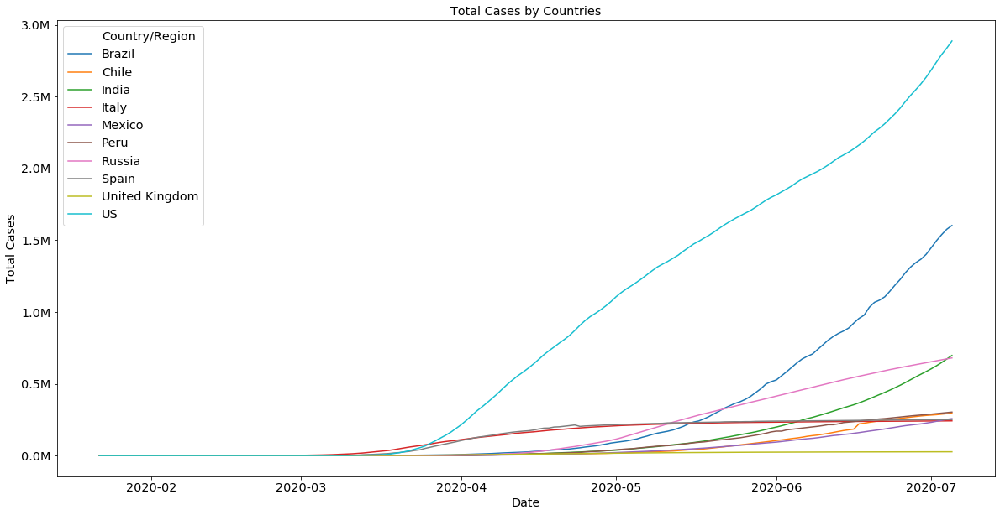

In [19]:
g = sns.lineplot(x='Date', y = 'Total Cases', data = Top10.reset_index(), hue = 'Country/Region',ci = None)
ylabels = ['{:,}'.format(x) + 'M' for x in g.get_yticks()/1000000]
g.set_yticklabels(ylabels)
params = {'legend.fontsize': 'x-large',
          'figure.figsize': (20, 10),
         'axes.labelsize': 'x-large',
         'axes.titlesize':'x-large',
         'xtick.labelsize':'x-large',
         'ytick.labelsize':'x-large'}
plt.title('Total Cases by Countries')
plt.rcParams.update(params);

## Trend of Daily Global New Cases

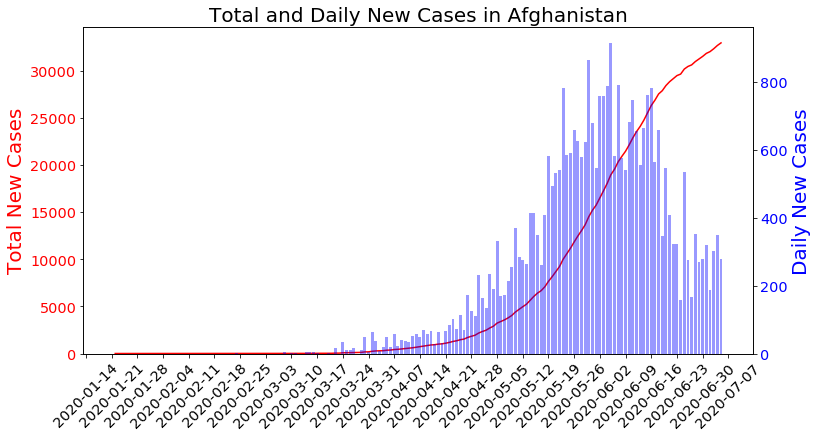

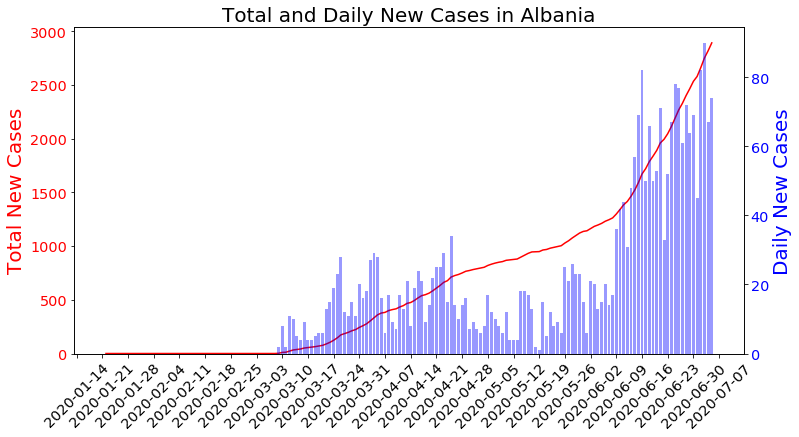

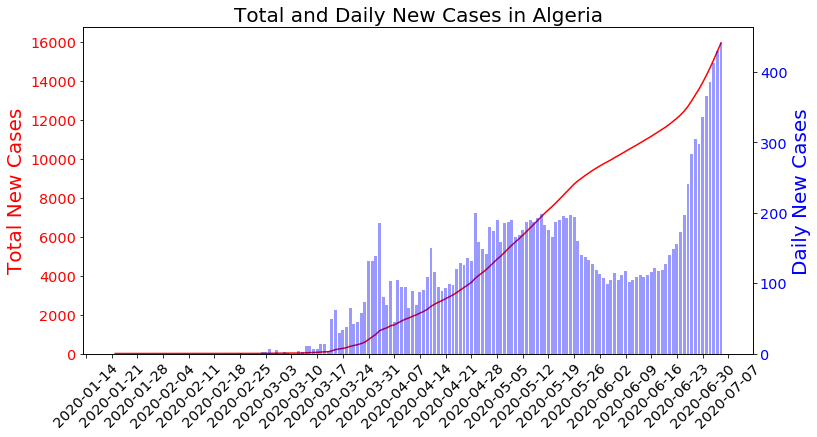

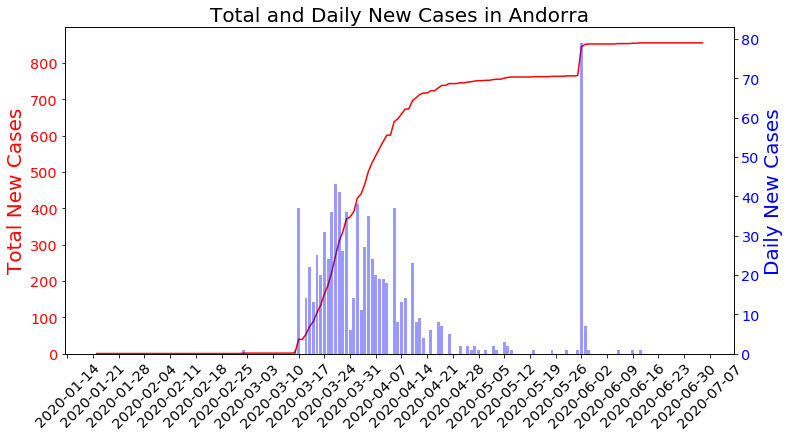

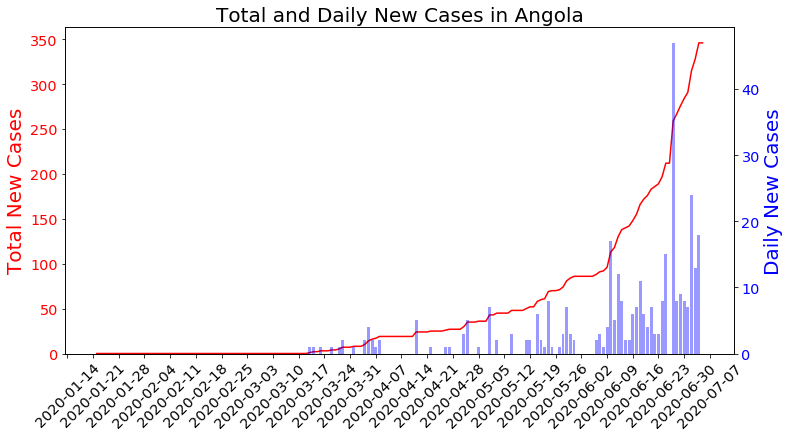

...

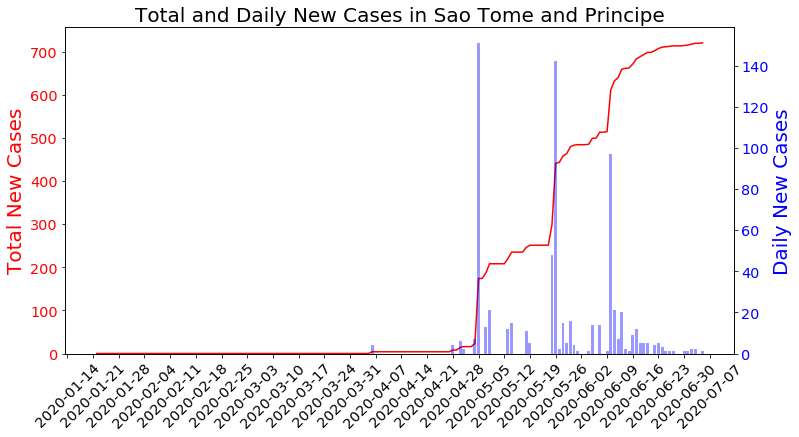

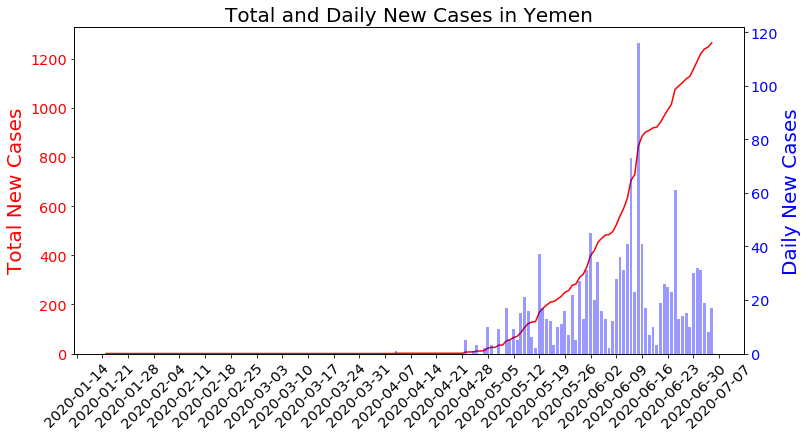

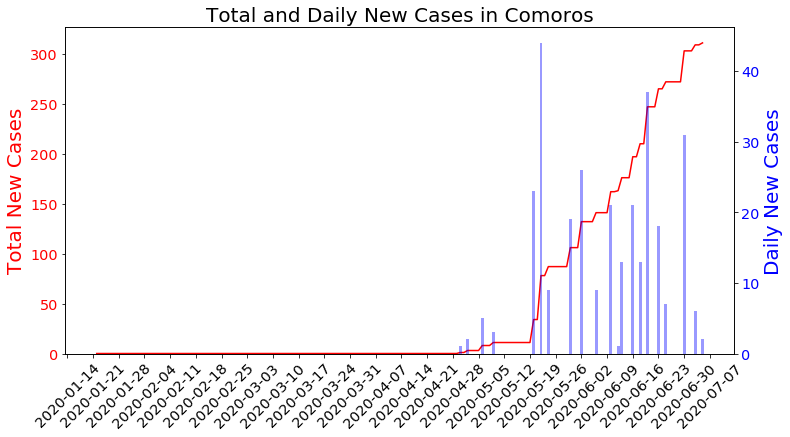

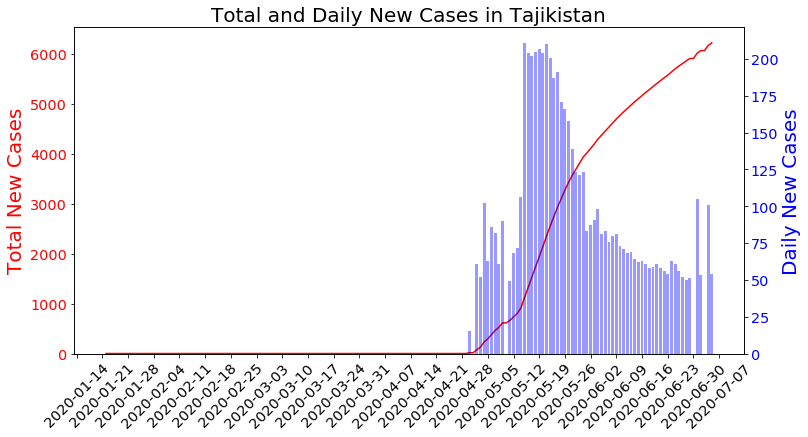

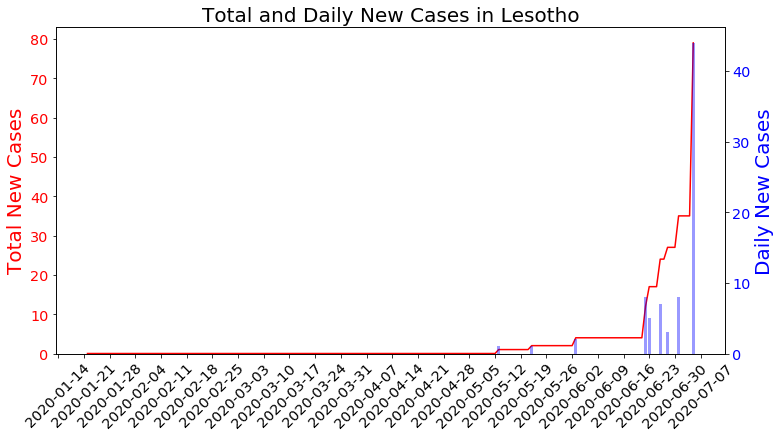

In [17]:
for region in regions:
    fig,ax1 = plt.subplots(figsize = (12,6))
    ax2 = ax1.twinx()
    ax1.plot(data_g['%s' % region]['Date'], data_g['%s' % region]['Total Cases'],'r-')
    ax1.tick_params(axis = 'y',labelcolor = 'r')
    ax1.tick_params(axis = 'x',labelrotation = 45)
    ax1.set_ylim(0)
    ax1.set_ylabel('Total New Cases', color = 'r',fontsize = 20)
    ax1.set_title('Total and Daily New Cases in %s' % region, fontsize = 20)
    
    ax2.bar(data_g['%s' % region]['Date'], data_g['%s' % region]['New Cases'],color = 'b',alpha = 0.4)
    ax2.tick_params(axis = 'y',labelcolor = 'b')
    ax2.set_ylabel('Daily New Cases', color = 'b',fontsize = 20)
    ax1.xaxis.set_major_locator(mdates.WeekdayLocator(interval = 1))
    plt.show();

### Trends of Daily Global Death and Recovered 

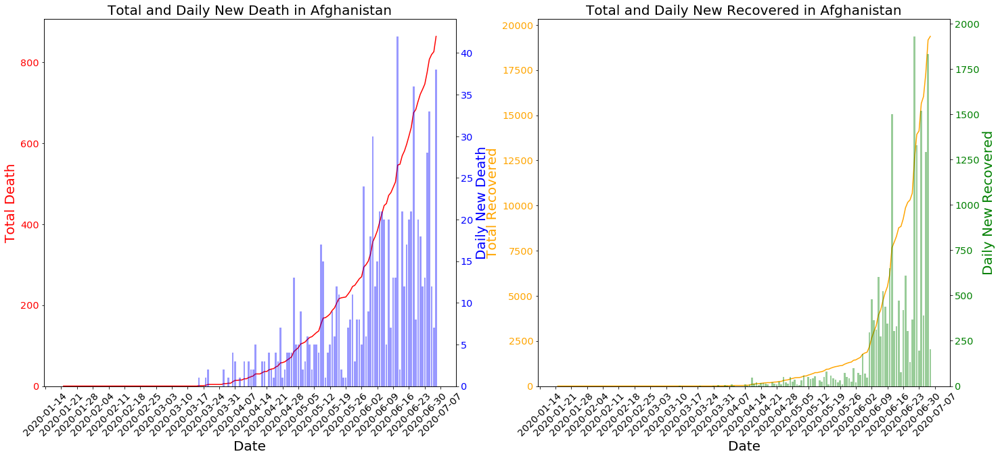

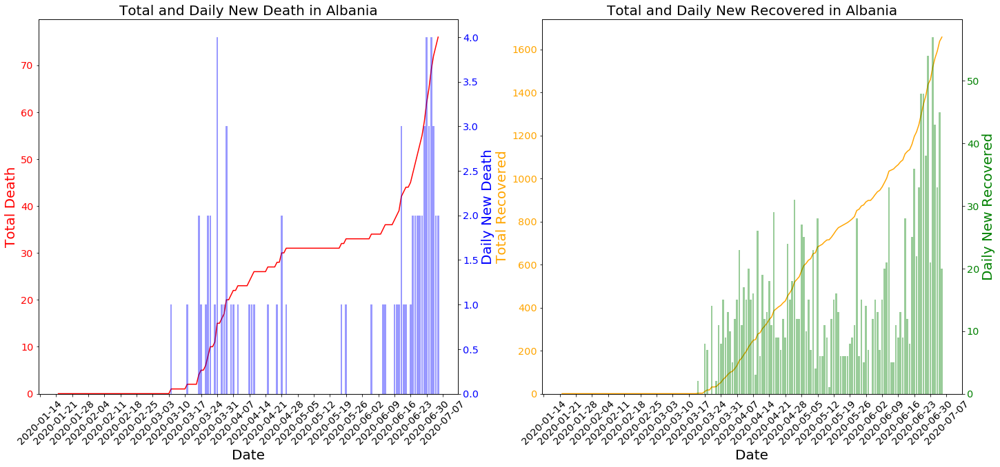

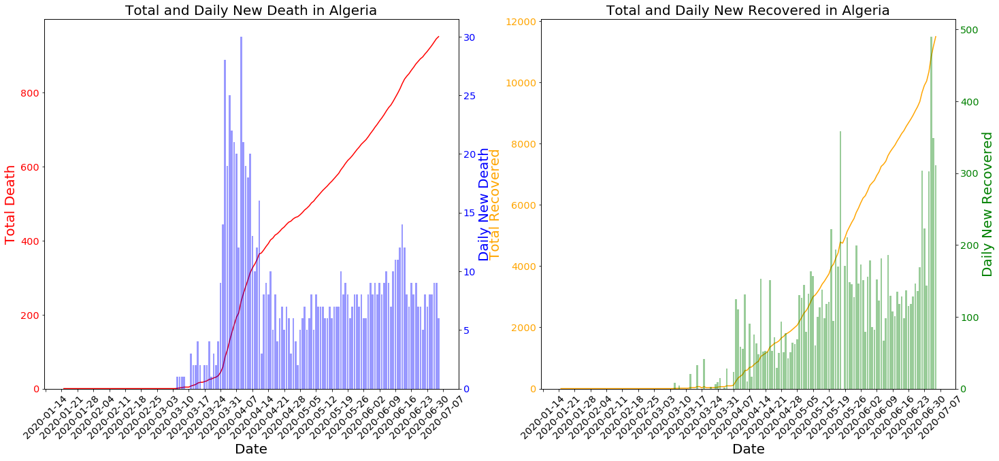

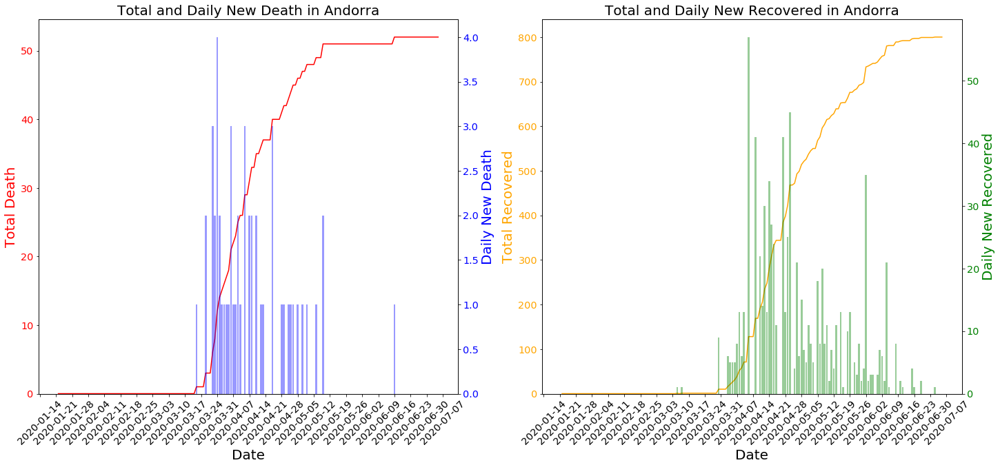

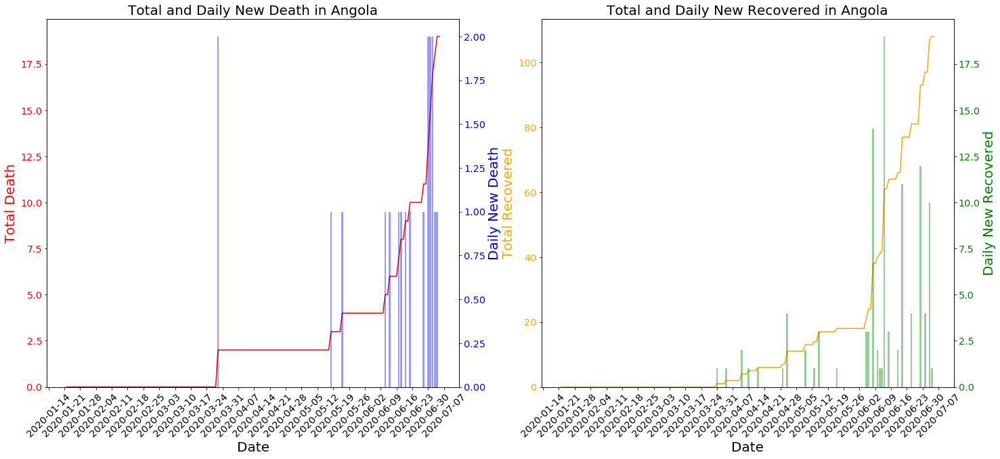

...

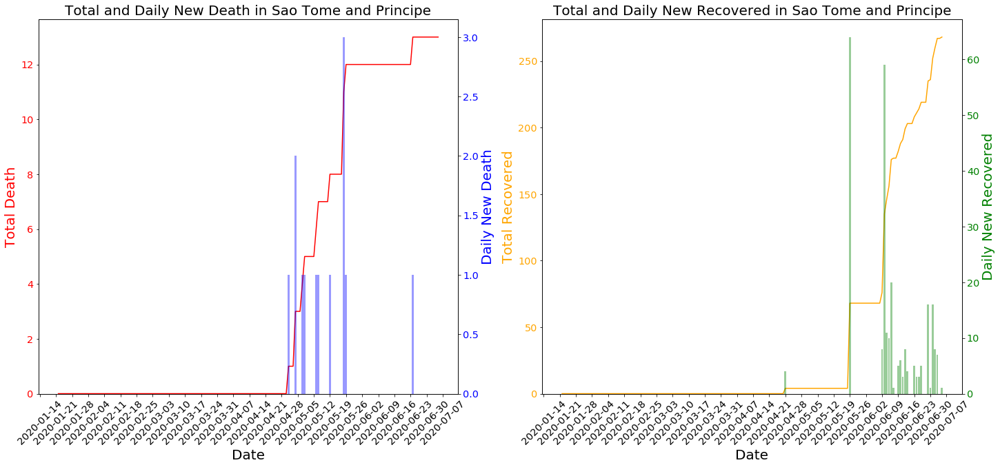

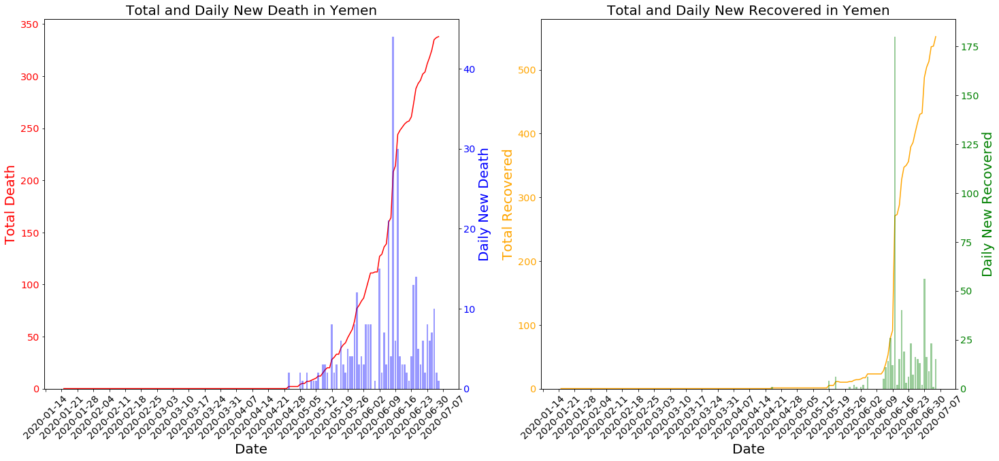

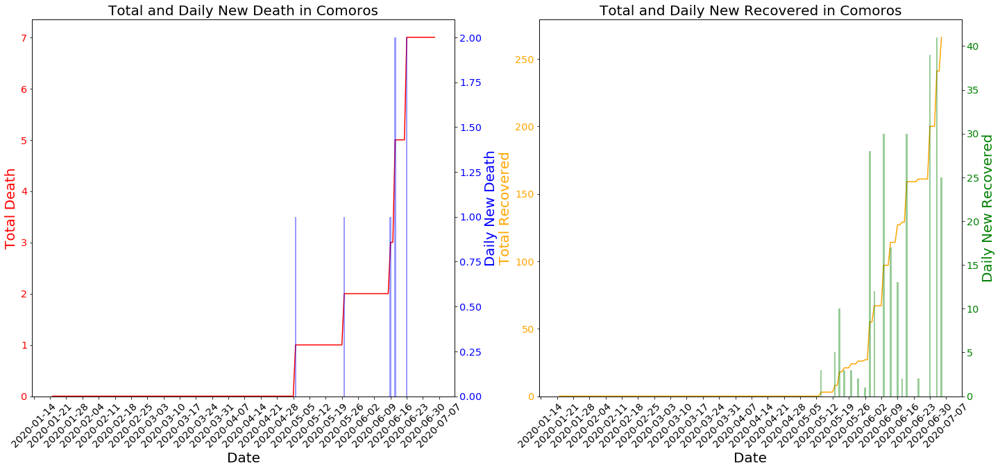

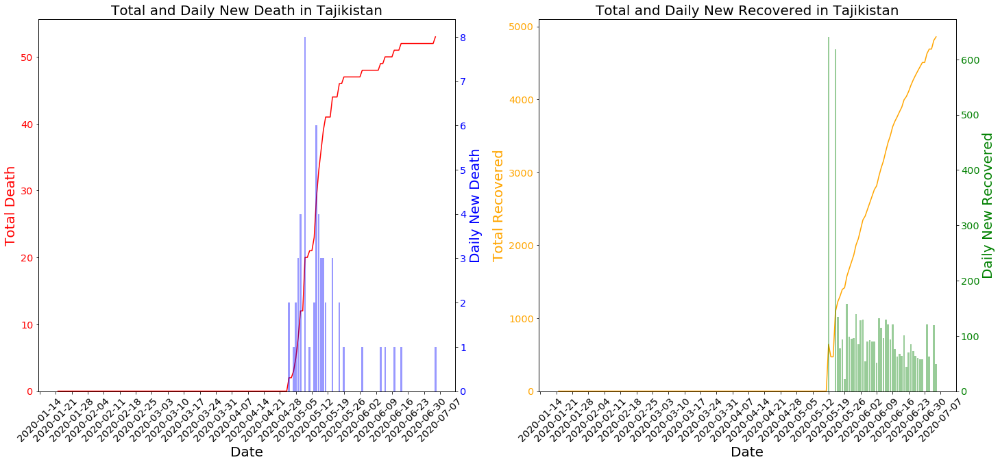

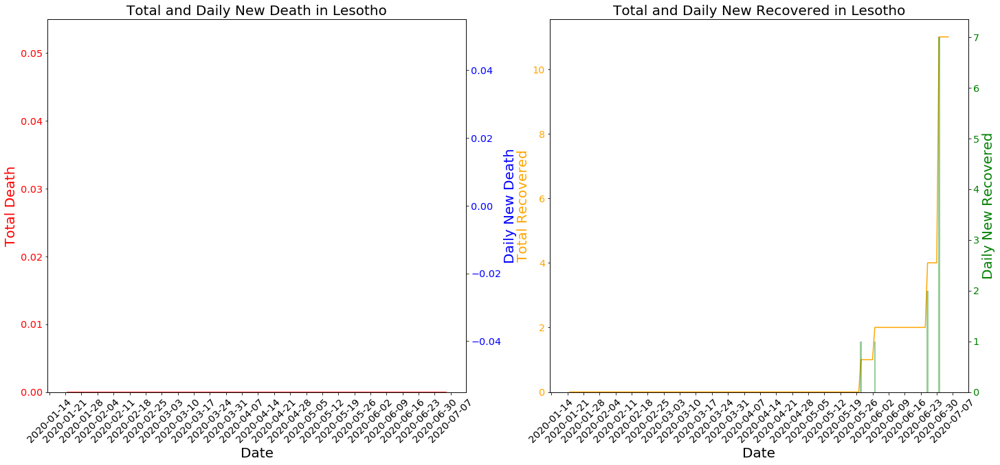

In [18]:
for region in regions:   
    fig, axs = plt.subplots(nrows = 1, ncols = 2, figsize=(24,10))
    ax2 = axs[0].twinx()
    ax3 = axs[1].twinx()
    axs[0].plot(data_g['%s' % region]['Date'], data_g['%s' % region]['Total Death'], 'r-')
    axs[0].tick_params(axis = 'y', labelcolor='r')
    axs[0].tick_params(axis = 'x', labelrotation = 45)
    axs[0].set_ylim(0)
    axs[0].set_xlabel('Date',fontsize = 20)
    axs[0].set_ylabel('Total Death', color='r',fontsize = 20)
    
    ax2.bar(data_g['%s' % region]['Date'],data_g['%s' % region]['New Death'], color = 'b', alpha= 0.4)
    ax2.tick_params(axis = 'y',labelcolor='b')
    ax2.set_ylabel('Daily New Death', color='b',fontsize = 20)
    
    axs[0].xaxis.set_major_locator(mdates.WeekdayLocator(interval=1))
    axs[0].set_title('Total and Daily New Death in %s' % region,fontsize = 20)

    axs[1].plot(data_g['%s' % region]['Date'], data_g['%s' % region]['Total Recovered'], '-',color = 'orange')
    axs[1].tick_params(axis = 'y', labelcolor='orange')
    axs[1].tick_params(axis = 'x', labelrotation = 45)
    axs[1].set_ylim(0)
    axs[1].set_xlabel('Date',fontsize = 20)
    axs[1].set_ylabel('Total Recovered', color='orange',fontsize = 20)
    ax3.bar(data_g['%s' % region]['Date'], data_g['%s' % region]['New Recovered'], color = 'green', alpha= 0.4)
    ax3.tick_params(axis = 'y',labelcolor='green')
    ax3.set_ylabel('Daily New Recovered', color='green',fontsize = 20)
    
    axs[1].xaxis.set_major_locator(mdates.WeekdayLocator(interval=1))
    axs[1].set_title('Total and Daily New Recovered in %s' %region,fontsize = 20)
    plt.show();